### **D2APR: Aprendizado de Máquina e Reconhecimento de Padrões** (IFSP, Campinas) <br/>
**Prof**: Samuel Martins (Samuka) <br/>


<a rel="license" href="http://creativecommons.org/licenses/by-nc-sa/4.0/"><img alt="Creative Commons License" style="border-width:0" src="https://i.creativecommons.org/l/by-nc-sa/4.0/88x31.png" /></a><br />This work is licensed under a <a rel="license" href="http://creativecommons.org/licenses/by-nc-sa/4.0/">Creative Commons Attribution-NonCommercial-ShareAlike 4.0 International License</a>. <br/><br/>

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report

sns.set_theme(style="whitegrid")

params = {'legend.fontsize': 'x-large',
          'figure.figsize': (15, 5),
         'axes.labelsize': 'x-large',
         'axes.titlesize':'x-large',
         'xtick.labelsize':'x-large',
         'ytick.labelsize':'x-large'}
plt.rcParams.update(params)

In [2]:
df = pd.read_csv('data-ex03.csv')

In [3]:
df.head()

,x1,x2,y
0,0.025592,0.005174,0
1,-0.377264,-0.787403,0
2,-0.521973,0.193584,0
3,-0.338581,0.496924,0
4,-0.275104,-0.238538,0


<AxesSubplot:xlabel='x1', ylabel='x2'>

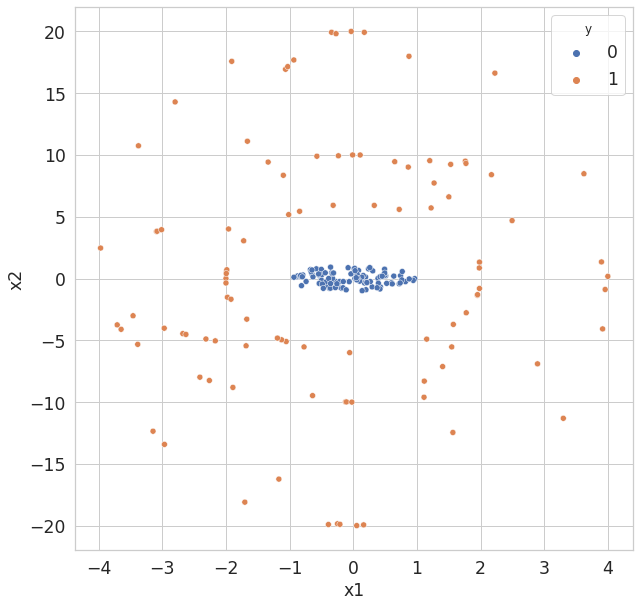

In [4]:
plt.figure(figsize=(10,10))
sns.scatterplot(data=df, x='x1', y='x2', hue='y')

In [5]:
X_train = df[['x1', 'x2']].values
y_train = df['y'].values

# Logistic Regression

In [6]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression

log_reg_clf = Pipeline([
    ("scaler", StandardScaler()),
    ("log_reg", LogisticRegression(random_state=42, penalty='none'))
])

log_reg_clf.fit(X_train, y_train)

Pipeline(steps=[('scaler', StandardScaler()),
                ('log_reg',
                 LogisticRegression(penalty='none', random_state=42))])

<span style='font-size: 20pt'>
$\theta_0 + \theta_1 * x_1 + \theta_2 * x_2 = 0$

$\theta_1 * x_1 + \theta_2 * x_2 = -\theta_0$
    
$x_2 = - (\theta_0 + \theta_1 * x_1) / \theta_2$
</span>

In [7]:
theta_0 = log_reg_clf.get_params()['log_reg'].intercept_[0]
theta_1, theta_2 = log_reg_clf.get_params()['log_reg'].coef_[0]

In [8]:
x1_db = np.random.uniform(X_train[:,0].min(), X_train[:,0].max()+0.01, 100)
x2_db = -(theta_0 + (theta_1 * x1_db)) / theta_2

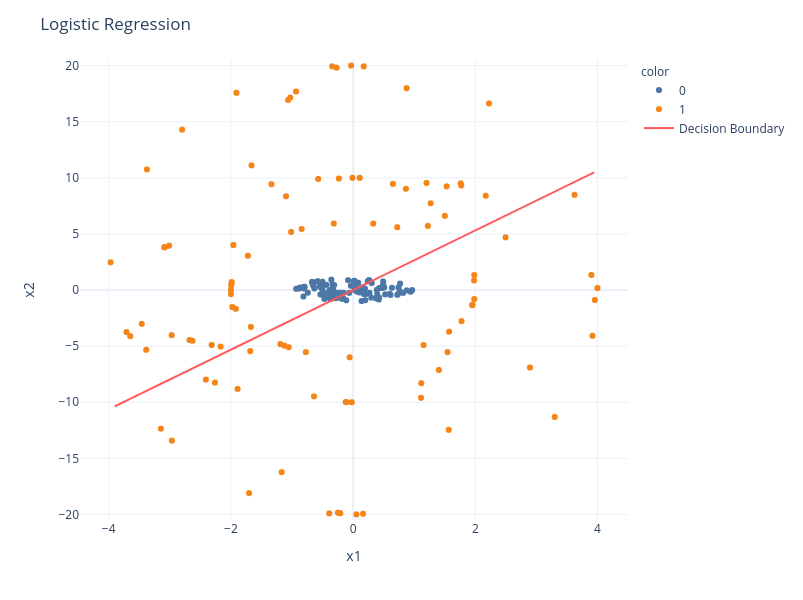

In [9]:
import plotly.express as px
import plotly.graph_objects as go

fig = px.scatter(x=X_train[:,0], y=X_train[:,1], color=y_train.astype('str'), color_discrete_sequence=px.colors.qualitative.T10)
fig.add_trace(go.Scatter(x=x1_db, y=x2_db, mode='lines', name='Decision Boundary', marker_color='#FF5657'))

fig.update_layout(title='Logistic Regression',
                  xaxis_title='x1', yaxis_title='x2', width=700, height=600, template='plotly_white')
fig.update_xaxes(range=[X_train[:,0].min() - 0.5, X_train[:,0].max() + 0.5])
fig.update_yaxes(range=[X_train[:,1].min() - 0.5, X_train[:,1].max() + 0.5])

fig.show()

In [10]:
y_train_pred = log_reg_clf.predict(X_train)
print(classification_report(y_train, y_train_pred))

              precision    recall  f1-score   support

           0       0.57      0.60      0.59       100
           1       0.58      0.55      0.56       100

    accuracy                           0.57       200
   macro avg       0.58      0.57      0.57       200
weighted avg       0.58      0.57      0.57       200



# Polynomial Logistic Regression

## Degree = 2

In [11]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import PolynomialFeatures
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression

pol_log_reg_clf = Pipeline([
    ('pol_feats', PolynomialFeatures(degree=2, include_bias=False)),
    ("scaler", StandardScaler()),
    ("log_reg", LogisticRegression(random_state=42, penalty='none')),
])

pol_log_reg_clf.fit(X_train, y_train)

Pipeline(steps=[('pol_feats', PolynomialFeatures(include_bias=False)),
                ('scaler', StandardScaler()),
                ('log_reg',
                 LogisticRegression(penalty='none', random_state=42))])

In [12]:
theta_0 = pol_log_reg_clf.get_params()['log_reg'].intercept_[0]
theta_1, theta_2, theta_3, theta_4, theta_5 = pol_log_reg_clf.get_params()['log_reg'].coef_[0]

In [13]:
x1_model = np.linspace(X_train[:,0].min(), X_train[:,0].max(), 1000)
x2_model = np.linspace(X_train[:,1].min(), X_train[:,1].max(), 1000)
x1v, x2v = np.meshgrid(x1_model, x2_model)
y_model = pol_log_reg_clf.predict_proba(np.array([x1v.ravel(), x2v.ravel()]).T)[:,1].reshape(x1v.shape)

In [14]:
# https://stackoverflow.com/a/53116010

import plotly.graph_objects as go

fig = go.Figure(data=[
                    go.Scatter3d(x=X_train[:,0], y=X_train[:,1], z=y_train, mode='markers',
                                marker=dict(size=6, color=y_train, colorscale=[[0, '#4C78A8'], [1, '#F58518']], opacity=0.8)),
                    go.Surface(x=x1_model, y=x2_model, z=y_model),
            ])


fig.update_layout(title='Polynomial Logistic Regression',
                  scene=dict(xaxis_title='x1', yaxis_title='x2', zaxis_title='y'), width=700, height=600, template='plotly_white')
fig.update_xaxes(range=[X_train[:,0].min() - 0.5, X_train[:,0].max() + 0.5])
fig.update_yaxes(range=[X_train[:,1].min() - 0.5, X_train[:,1].max() + 0.5])

fig.show()

In [15]:
mask = (y_model >= 0.495) & (y_model <= 0.505)
x1_db = x1v[mask].ravel()
x2_db = x2v[mask].ravel()

In [16]:
import plotly.express as px
import plotly.graph_objects as go

fig = px.scatter(x=X_train[:,0], y=X_train[:,1], color=y_train.astype('str'), color_discrete_sequence=px.colors.qualitative.T10)
fig.add_trace(go.Scatter(x=x1_db, y=x2_db, mode='markers', name='Decision Boundary', marker_color='#FF5657'))

fig.update_layout(title='Logistic Regression',
                  xaxis_title='x1', yaxis_title='x2', width=700, height=600)
fig.update_xaxes(range=[X_train[:,0].min() - 0.5, X_train[:,0].max() + 0.5])
fig.update_yaxes(range=[X_train[:,1].min() - 0.5, X_train[:,1].max() + 0.5])

fig.show()

In [17]:
import plotly.express as px
import plotly.graph_objects as go

fig = px.scatter(x=X_train[:,0], y=X_train[:,1], color=y_train.astype('str'), color_discrete_sequence=px.colors.qualitative.T10)
fig.add_trace(go.Scatter(x=x1_db, y=x2_db, mode='markers', name='Decision Boundary', marker_color='#FF5657'))

fig.update_layout(title='Logistic Regression',
                  xaxis_title='x1', yaxis_title='x2', width=700, height=600)
fig.update_xaxes(range=[X_train[:,0].min() - 0.5, X_train[:,0].max() + 0.5])
fig.update_yaxes(range=[X_train[:,1].min() - 0.5, X_train[:,1].max() + 0.5])

fig.show()

In [18]:
y_train_pred = pol_log_reg_clf.predict(X_train)
print(classification_report(y_train, y_train_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00       100
           1       1.00      1.00      1.00       100

    accuracy                           1.00       200
   macro avg       1.00      1.00      1.00       200
weighted avg       1.00      1.00      1.00       200



## Degree = 50

In [19]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import PolynomialFeatures
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression

pol_log_reg_clf = Pipeline([
    ('pol_feats', PolynomialFeatures(degree=50, include_bias=False, interaction_only=False)),
    ("scaler", StandardScaler()),
    ("log_reg", LogisticRegression(random_state=42, penalty='none')),
])

pol_log_reg_clf.fit(X_train, y_train)

Pipeline(steps=[('pol_feats',
                 PolynomialFeatures(degree=50, include_bias=False)),
                ('scaler', StandardScaler()),
                ('log_reg',
                 LogisticRegression(penalty='none', random_state=42))])

In [20]:
x1_model = np.linspace(X_train[:,0].min(), X_train[:,0].max(), 500)
x2_model = np.linspace(X_train[:,1].min(), X_train[:,1].max(), 500)
x1v, x2v = np.meshgrid(x1_model, x2_model)
y_model = pol_log_reg_clf.predict_proba(np.array([x1v.ravel(), x2v.ravel()]).T)[:,1].reshape(x1v.shape)

In [21]:
# https://stackoverflow.com/a/53116010

import plotly.graph_objects as go

fig = go.Figure(data=[
                    go.Scatter3d(x=X_train[:,0], y=X_train[:,1], z=y_train, mode='markers',
                                marker=dict(size=6, color=y_train, colorscale=[[0, '#4C78A8'], [1, '#F58518']], opacity=0.8)),
                    go.Surface(x=x1_model, y=x2_model, z=y_model),
            ])


fig.update_layout(title='Polynomial Logistic Regression',
                  scene=dict(xaxis_title='x1', yaxis_title='x2', zaxis_title='y'), width=700, height=600)
fig.update_xaxes(range=[X_train[:,0].min() - 0.5, X_train[:,0].max() + 0.5])
fig.update_yaxes(range=[X_train[:,1].min() - 0.5, X_train[:,1].max() + 0.5])

fig.show()

In [22]:
mask = (y_model >= 0.495) & (y_model <= 0.505)
x1_db = x1v[mask].ravel()
x2_db = x2v[mask].ravel()

In [24]:
# I COULD NOT CORRECTLY PLOT THE DECISION BOUNDARY AS A LINE PLOT
import plotly.express as px
import plotly.graph_objects as go

fig = px.scatter(x=X_train[:,0], y=X_train[:,1], color=y_train.astype('str'), color_discrete_sequence=px.colors.qualitative.T10)
fig.add_trace(go.Scatter(x=x1_db, y=x2_db, mode='lines', name='Decision Boundary'))

fig.update_layout(title='Logistic Regression',
                  xaxis_title='x1', yaxis_title='x2', width=700, height=600)
fig.update_xaxes(range=[X_train[:,0].min() - 0.5, X_train[:,0].max() + 0.5])
fig.update_yaxes(range=[X_train[:,1].min() - 0.5, X_train[:,1].max() + 0.5])

fig.show()

In [25]:
# SO I PLOT SOME POINTS OVER THE DECISION BOUNDARY
import plotly.express as px
import plotly.graph_objects as go

fig = px.scatter(x=X_train[:,0], y=X_train[:,1], color=y_train.astype('str'), color_discrete_sequence=px.colors.qualitative.T10)
fig.add_trace(go.Scatter(x=x1_db, y=x2_db, mode='markers', name='Decision Boundary'))

fig.update_layout(title='Logistic Regression',
                  xaxis_title='x1', yaxis_title='x2', width=700, height=600)
fig.update_xaxes(range=[X_train[:,0].min() - 0.5, X_train[:,0].max() + 0.5])
fig.update_yaxes(range=[X_train[:,1].min() - 0.5, X_train[:,1].max() + 0.5])

fig.show()

In [26]:
y_train_pred = pol_log_reg_clf.predict(X_train)
print(classification_report(y_train, y_train_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00       100
           1       1.00      1.00      1.00       100

    accuracy                           1.00       200
   macro avg       1.00      1.00      1.00       200
weighted avg       1.00      1.00      1.00       200

